In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import GradientBoostingClassifier

from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import plot_roc_curve

from pdpbox import pdp
import eli5
from eli5.sklearn import PermutationImportance
import shap

sns.set()

### 1. Чтение и обзор данных

In [ ]:
file_name = 'tds.tsv'
data = pd.read_csv(file_name, sep = '\t', decimal=',', index_col = None)

data

    Есть ли пропущенные?

In [94]:
data.isna().sum().sum()

0

    Какая корреляция между признаками?

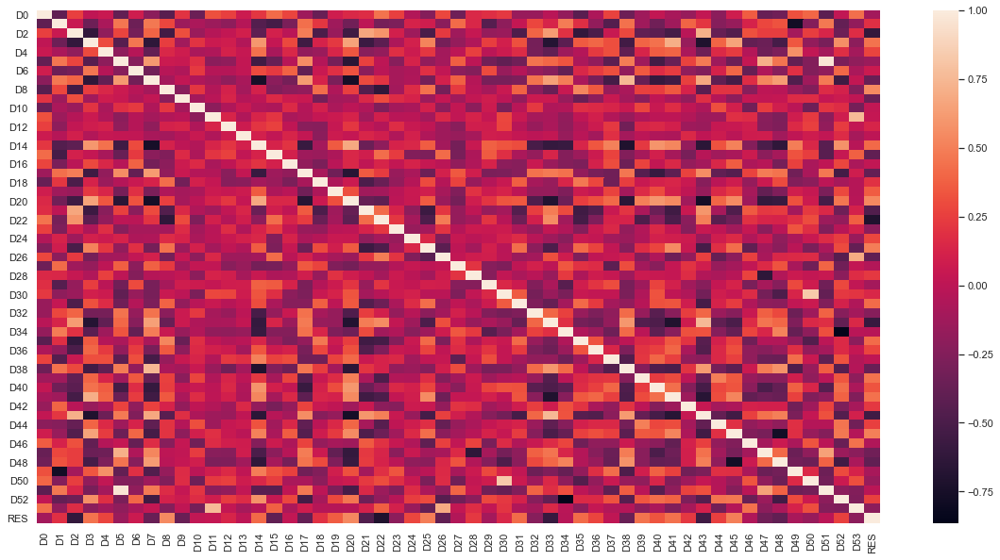

In [20]:
feature_correlation = data.corr(method='spearman')
plt.figure(figsize=(20,10))
sns.heatmap(feature_correlation)
plt.show()

    Значение |сorr|   Интерпретация
    от 0 до 0.3      очень слабая
    от 0.3 до 0.5    слабая
    от 0.5 до 0.7    средняя
    от 0.7 до 0.9    высокая
    от 0.9 до 1      очень высокая

    Выберем только те признаки, которые имеют хотя бы слабую корреляцию (>0.3) 
    с целевым признаком

In [248]:
selected_corr_matrix = feature_correlation[(feature_correlation > 0.3) | (feature_correlation < -0.3)]

    Коррелирующие с целевой переменной признаки

In [23]:
selected_corr_matrix['RES'][~selected_corr_matrix['RES'].isna()]

D2    -0.615186
D3     0.453517
D7    -0.367040
D8     0.542296
D9    -0.358542
D14    0.410546
D15   -0.396990
D17   -0.379580
D19    0.363019
D20    0.535818
D21   -0.465171
D22   -0.709050
D25    0.496214
D26   -0.391651
D31    0.418940
D33   -0.589060
D35    0.421915
D38   -0.365406
D39    0.447495
D40    0.335458
D41    0.441403
D43   -0.546175
D45    0.504364
D47   -0.330219
D48   -0.391610
RES    1.000000
Name: RES, dtype: float64

In [246]:
corr_features = selected_corr_matrix['RES'][~selected_corr_matrix['RES'].isna()].index.to_list()
selected_corr_matrix = selected_corr_matrix.loc[corr_features, corr_features]
selected_corr_matrix.head(15)

,D2,D3,D7,D8,D9,D14,D15,D17,D19,D20,...,D35,D38,D39,D40,D41,D43,D45,D47,D48,RES
D2,1.000000,-0.609877,0.395351,-0.540476,0.308415,-0.411648,NaN,0.496560,NaN,-0.553042,...,-0.609277,NaN,-0.397413,-0.425747,-0.522077,0.715047,-0.463101,NaN,NaN,-0.615186
D3,-0.609877,1.000000,-0.634204,NaN,NaN,0.604903,NaN,-0.557426,NaN,0.656570,...,0.354695,-0.542376,0.394679,0.445988,0.703297,-0.708735,0.652875,-0.353296,-0.519278,0.453517
D7,0.395351,-0.634204,1.000000,NaN,NaN,-0.750570,NaN,0.617072,NaN,-0.757958,...,NaN,0.748354,-0.371165,-0.600294,-0.545910,0.677997,-0.525414,0.527037,0.623357,-0.367040
D8,-0.540476,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,0.532644,NaN,NaN,NaN,0.346980,-0.427711,NaN,NaN,NaN,0.542296
D9,0.308415,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,...,-0.358892,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.358542
D14,-0.411648,0.604903,-0.750570,NaN,NaN,1.000000,NaN,-0.581901,0.355241,0.679679,...,NaN,-0.704688,NaN,0.590408,0.529576,-0.651312,0.505449,-0.495588,-0.628881,0.410546
D15,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.396990
D17,0.496560,-0.557426,0.617072,NaN,NaN,-0.581901,NaN,1.000000,-0.328357,-0.672334,...,NaN,0.467804,-0.444635,-0.584901,-0.411240,0.556164,-0.442240,0.487044,0.452773,-0.379580
D19,NaN,NaN,NaN,NaN,NaN,0.355241,NaN,-0.328357,1.000000,0.309465,...,NaN,NaN,NaN,0.306210,NaN,NaN,NaN,-0.386203,NaN,0.363019
D20,-0.553042,0.656570,-0.757958,NaN,NaN,0.679679,NaN,-0.672334,0.309465,1.000000,...,NaN,-0.646759,0.500832,0.601159,0.545515,-0.760776,0.555690,-0.604864,-0.587288,0.535818


    Сильно коррелирующие между собой признаки могут портить предсказание. Выберем те пары, корреляция у которых превышает 0.7

In [330]:
high_corr_matrix = selected_corr_matrix[(selected_corr_matrix > 0.7) | (selected_corr_matrix < -0.7)]
high_corr_matrix.head(21)

,D0,D1,D2,D3,D4,D5,D6,D7,D8,D9,...,D45,D46,D47,D48,D49,D50,D51,D52,D53,RES
D0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D1,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,-0.775471,NaN,NaN,NaN,NaN,NaN
D2,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D3,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D4,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D5,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,...,NaN,NaN,0.711342,NaN,NaN,NaN,0.966496,NaN,NaN,NaN
D6,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


    Посмотрим на форму графиков взаимосвязи выбранных признаков, 
    а также на  распределение целевого признака

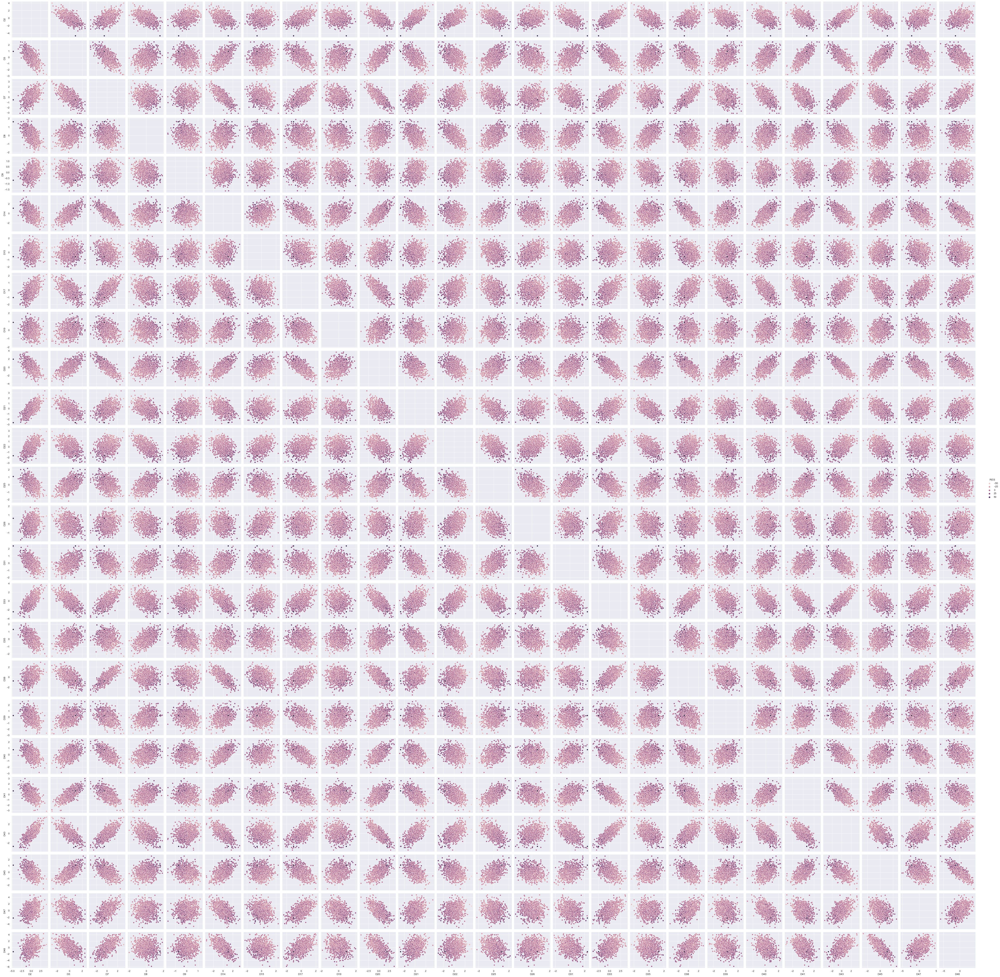

In [49]:
sns.pairplot(data=data.loc[:, corr_features].sample(1000), 
             hue='RES')

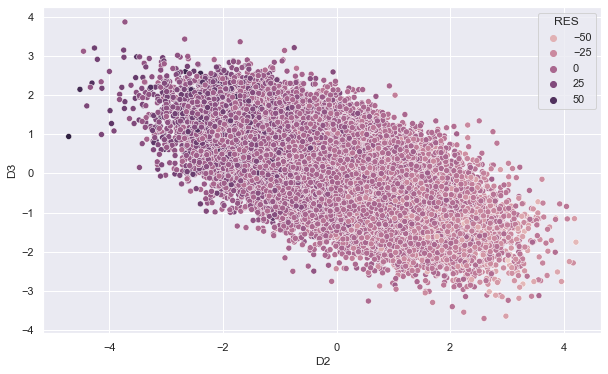

In [54]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=data, x='D2', y='D3', hue='RES')
plt.show()

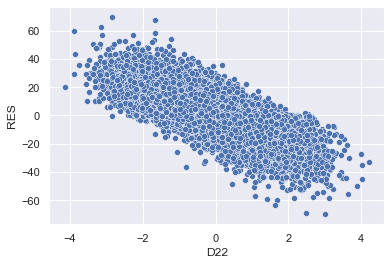

In [177]:
sns.scatterplot(data=data, x='D22', y='RES')
plt.show()

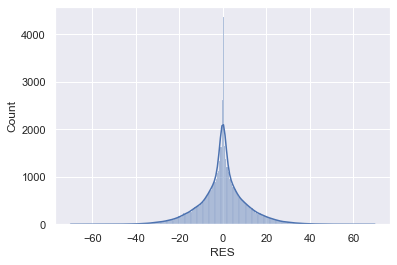

In [163]:
# plt.figure(figsize=(10, 6))
sns.histplot(data=data['RES'], kde=True)
plt.show()

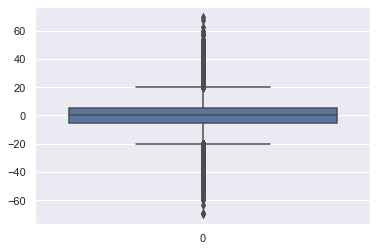

In [162]:
# plt.figure(figsize=(10, 6))
sns.boxplot(data=data['RES'])
plt.show()

### 2. Сравнение вклада признаков

In [173]:
x_full = data.drop('RES', axis='columns')
y_full = data['RES']
x_train, x_test, y_train, y_test = train_test_split(x_full, y_full, random_state=42)

print(f'X_train shape = {x_train.shape},\n'
      f'X_test shape = {x_test.shape}')
     

X_train shape = (37500, 54),
X_test shape = (12500, 54)


In [174]:
forest_model = RandomForestRegressor(random_state=42, n_jobs=-1)
forest_model.fit(x_train, y_train)
forest_predictions = forest_model.predict(x_test)

Рейтинг признаков:
D22  -  0.4963590872550191
D48  -  0.06795498122635903
D19  -  0.0625028604833382
D2  -  0.030116769816906606
D38  -  0.029518386976207674
D15  -  0.02734949156710862
D8  -  0.021527793750923136
D9  -  0.019371912722991935
D24  -  0.018368592970774058
D0  -  0.013975198906349282
D46  -  0.013257568642227322
D44  -  0.011344743129388206
D45  -  0.009923150032743645
D31  -  0.009454380015964933
D28  -  0.00830678668796133
D42  -  0.00817251425649429


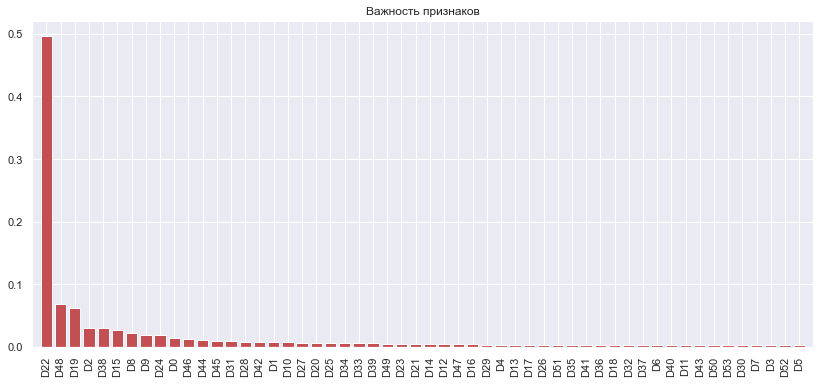

In [196]:
importances = forest_model.feature_importances_
std = np.std([forest_model.feature_importances_ for tree in forest_model.estimators_], axis=0)
indices = np.argsort(importances)[::-1]

rating_of_features = dict()

print("Рейтинг признаков:")

for i in range(x_train.shape[1]):
    rating_of_features[x_train.columns[indices[i]]] = importances[indices[i]]
    if i <= 15:
        print(x_train.columns[indices[i]]," - ", importances[indices[i]])

plt.figure(figsize=(14,6))
plt.title("Важность признаков")
plt.bar(range(x_train.shape[1]), importances[indices],
        color="r", yerr=std[indices], align="center")
plt.xticks(range(x_train.shape[1]), x_train.iloc[:, indices].columns, rotation=90)
plt.xlim([-1, x_train.shape[1]])
plt.show()

    Сравним со списком признаков, которые имеют хотя бы слабую корреляцию 
    и оставим только те признаки, которые дают наибольший вклад

In [190]:
x_train.columns[indices[:30]].values

array(['D22', 'D48', 'D19', 'D2', 'D38', 'D15', 'D8', 'D9', 'D24', 'D0',
       'D46', 'D44', 'D45', 'D31', 'D28', 'D42', 'D1', 'D10', 'D27',
       'D20', 'D25', 'D34', 'D33', 'D39', 'D49', 'D23', 'D21', 'D14',
       'D12', 'D47'], dtype=object)

In [211]:
print(corr_series.drop('RES').index.to_list())

['D2', 'D3', 'D7', 'D8', 'D9', 'D14', 'D15', 'D17', 'D19', 'D20', 'D21', 'D22', 'D25', 'D26', 'D31', 'D33', 'D35', 'D38', 'D39', 'D40', 'D41', 'D43', 'D45', 'D47', 'D48']


    Посмотрим на те элементы, которые не входят в топ-30 по значимости и имеют низкую корреляцию с целевым признаком

In [213]:
set_a = set(x_train.columns[indices[:30]].values)
set_b = set(corr_series.drop('RES').index.to_list())

print('Признак - уровень значимости')

for feature in (set_a ^ set_b):
    print('{:3} - {:.4}'.format(feature, rating_of_features[feature]))

Признак - уровень значимости
D26 - 0.003334
D0  - 0.01398
D34 - 0.005726
D42 - 0.008173
D43 - 0.002912
D46 - 0.01326
D49 - 0.005009
D12 - 0.004278
D10 - 0.00733
D17 - 0.003368
D23 - 0.004984
D28 - 0.008307
D3  - 0.002664
D44 - 0.01134
D35 - 0.003241
D27 - 0.006484
D24 - 0.01837
D7  - 0.002726
D41 - 0.003186
D40 - 0.002975
D1  - 0.007843


    Все эти признаки имеют низкий уровень значимости. Оставим только те, 
    которые имеют значение выше 0.01 (вручную выбранный порог).
    
    В конечном счете остаются признаки:
    

In [384]:
best_features = set()
for feature in (set_a ^ set_b):
    if rating_of_features[feature] >= 0.01:
        print('{:3} - {:.4}'.format(feature, rating_of_features[feature]))
        best_features.add(feature)
        
best_features = best_features.union(set_a & set_b)

best_features = [feature for feature in x_train.columns if feature in best_features]
print('\nВсе лучшие признаки: ', *best_features)
print('\nКоличество = ', len(best_features))



D0  - 0.01398
D46 - 0.01326
D44 - 0.01134
D24 - 0.01837

Все лучшие признаки:  D0 D2 D8 D9 D14 D15 D19 D20 D21 D22 D24 D25 D31 D33 D38 D39 D44 D45 D46 D47 D48

Количество =  21


    Посмотрим, коррелируют ли оставшиеся признаки между собой?

In [385]:
def find_col_by_index(index, list_of_features):
    return list_of_features[index]

corr_pairs = []

for i in range(0, feature_correlation.shape[0] - 1):
    for j in range(i):
        
        feature_1 =  find_col_by_index(i, x_train.columns.to_list())
        feature_2 =  find_col_by_index(j, x_train.columns.to_list())
        
        if (abs(feature_correlation.iloc[i, j]) > 0.7 and 
            feature_1 in best_features and feature_2 in best_features):
            
            print('{}, value={}'
                  .format((feature_1, feature_2), feature_correlation.iloc[i, j]))
            corr_pairs.append((feature_1, feature_2))


('D38', 'D14'), value=-0.7046881603952833
('D48', 'D45'), value=-0.7679329144376371


    Кандидаты на удаление 'D14', 'D45', так как имеют меньший уровень значимости

     Сравнение результатов: 1) до удаления признаков, 2) если удалить первый признак, 
     3) если удалить второй признак и 4) если удалить оба признака. Как видно, 
     они не дают большого вклада в общее предсказания, но и не ухудшают модель.  
     
     model      mae         mse         rms         r2_square
    full LR     3.066383    15.800670   3.975006    0.874428
    (-D14)      3.064648    15.843168   3.980348    0.870944
    (-D45)      3.066597    15.8895     3.986164    0.870567
    (-D14,-D45) 3.06852     15.901678   3.987691    0.870468

### 3. Обучение и сравнение моделей

In [386]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor 
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor

from sklearn import metrics
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

    Разделение данных

In [387]:
x_full = data[best_features].drop(['D14', 'D45'], axis='columns')
y_full = data['RES']

In [388]:
x_train, x_test, y_train, y_test = train_test_split(x_full, y_full, random_state=42)

In [371]:
print(f'X_train shape = {x_train.shape},\n'
      f'X_test shape = {x_test.shape}')

X_train shape = (37500, 19),
X_test shape = (12500, 19)


    Сравнение моделей

In [372]:
def evaluate(y_true, y_predicted):
    mae = metrics.mean_absolute_error(y_true, y_predicted)
    mse = metrics.mean_squared_error(y_true, y_predicted)
    rmse = np.sqrt(metrics.mean_squared_error(y_true, y_predicted))
    r2_square = metrics.r2_score(y_true, y_predicted)
    return mae, mse, rmse, r2_square

def predict(model, x_train, y_train, x_test, *args, **kwargs):
    if args is None:
        args = []
    if kwargs is None:
        kwargs = dict()
    predict_model = model(*args, **kwargs)
    predict_model.fit(x_train, y_train)
    y_pred = predict_model.predict(x_test)
    return y_pred

def plot_model_prediction(y_true, y_pred, title=None):
    ax = sns.kdeplot(x=y_true, color='r', label='Actual value')
    sns.kdeplot(x=y_pred, color='b', label='Predicted value', ax=ax)
    plt.legend()
    if not title is None:
        ax.set(title=title)
    plt.show()
    return ax

def compare_scores(y_true, y_pred, model_name=None, columns=None):
    if columns is None:
        columns=['model', 'mae', 'mse', 'rmse', 'r2_square']
    if model_name is None:
        model_name = 'Some regressor'
    df_scores = pd.DataFrame(columns=columns)
    results_append = pd.DataFrame(data=[[model_name, *evaluate(y_true, y_pred)]], 
                                  columns=df_scores.columns)
    df_scores = df_scores.append(results_append, ignore_index=True)
    
    return df_scores
            
def compare_models(x_train, y_train, x_test, y_test, models, models_params=None,
                   show=True):
    columns=['model', 'mae', 'mse', 'rmse', 'r2_square']
    df_scores = pd.DataFrame(columns=columns)
    if models_params is None: 
        models_params = dict()
    for model in models:
        if model in models_params:
            params = models_params.get(model)
            y_pred = predict(model, x_train, y_train, x_test, **params)
        else:
            y_pred = predict(model, x_train, y_train, x_test)
        score = compare_scores(y_test, y_pred, model_name=model.__name__)
        if show:
            plot_model_prediction(y_test, y_pred, title=model.__name__)
        print(f'{model.__name__} finished')
        df_scores = pd.concat([df_scores, score])
        
    return df_scores

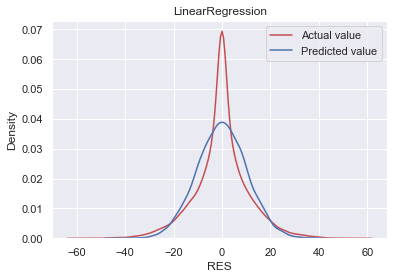

LinearRegression finished


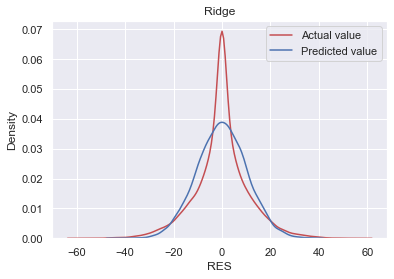

Ridge finished


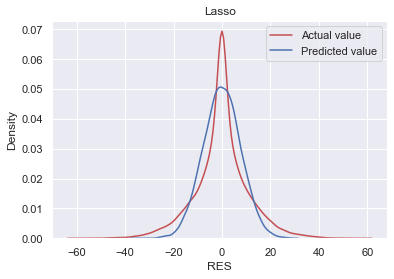

Lasso finished


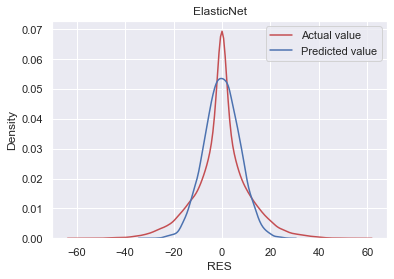

ElasticNet finished


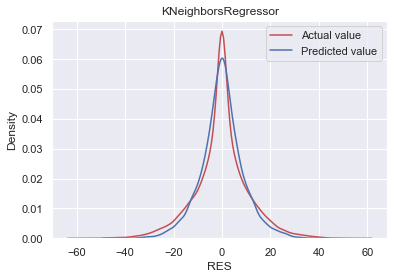

KNeighborsRegressor finished


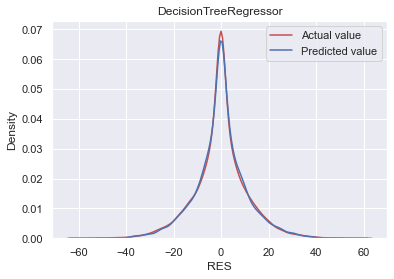

DecisionTreeRegressor finished


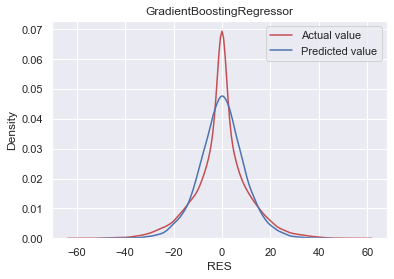

GradientBoostingRegressor finished


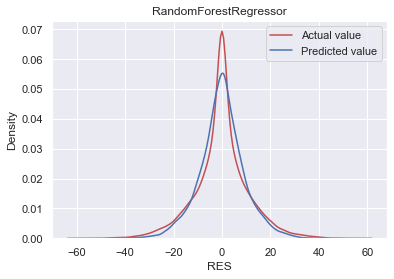

RandomForestRegressor finished


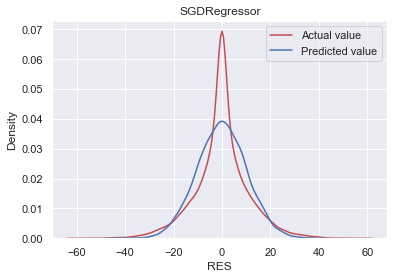

SGDRegressor finished


In [373]:
from sklearn.linear_model import SGDRegressor

list_of_models = [
    LinearRegression,
    Ridge, 
    Lasso, 
    ElasticNet, 
    KNeighborsRegressor, 
    DecisionTreeRegressor, 
    GradientBoostingRegressor, 
    RandomForestRegressor,
    SGDRegressor
]
dict_of_params = {
    LinearRegression: {'n_jobs': -1},
    KNeighborsRegressor: {'n_jobs': -1},
    RandomForestRegressor: {'n_jobs': -1},
}

df_scores = compare_models(x_train, y_train, x_test, y_test, 
                           models=list_of_models, 
                           models_params=dict_of_params)

In [374]:
df_scores

,model,mae,mse,rmse,r2_square
0,LinearRegression,3.068520,15.901678,3.987691,0.870468
0,Ridge,3.068494,15.901758,3.987701,0.870467
0,Lasso,4.619758,38.408184,6.197434,0.687134
0,ElasticNet,4.469167,37.109808,6.091782,0.697710
0,KNeighborsRegressor,4.035904,29.419443,5.423969,0.760355
0,DecisionTreeRegressor,5.603306,55.892045,7.476098,0.544714
0,GradientBoostingRegressor,3.415218,20.688924,4.548508,0.831472
0,RandomForestRegressor,3.624902,23.584295,4.856366,0.807887
0,SGDRegressor,3.068444,15.933594,3.991691,0.870208


    Посмотрим, поможет ли предобработка признаков (Scale, MinMax, Normalize)

In [375]:
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

In [376]:
def feature_encoding(features, encoder, x_train, x_test, x_valid,
                     y_train=None, *args, **kwargs):
    
    encoder = encoder(*args, **kwargs)
    if y_train is not None:
        encoder.fit(x_train[features], y_train)
    else:
        encoder.fit(x_train[features])
    
    x_train_ = pd.DataFrame(encoder.transform(x_train[features]))    
    x_train_.index = x_train[features].index
    x_train_.columns = x_train[features].columns

    x_test_ = pd.DataFrame(encoder.transform(x_test[features]))
    x_test_.index = x_test[features].index
    x_test_.columns = x_test[features].columns
    
    x_valid_ = pd.DataFrame(encoder.transform(x_valid[features]))
    x_valid_.index = x_valid[features].index
    x_valid_.columns = x_valid[features].columns  
    
    return x_train_, x_test_, x_valid_

In [377]:
minmax_features = x_train.columns

x_train_encoded, x_test_encoded, x_valid_encoded = (
    feature_encoding(
        minmax_features, StandardScaler, x_train, x_test, x_valid))

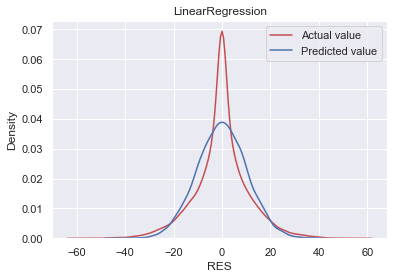

LinearRegression finished


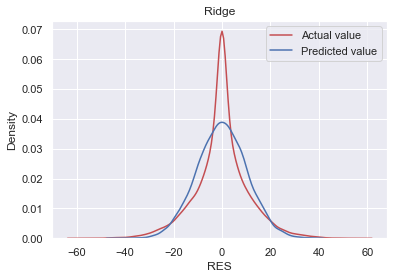

Ridge finished


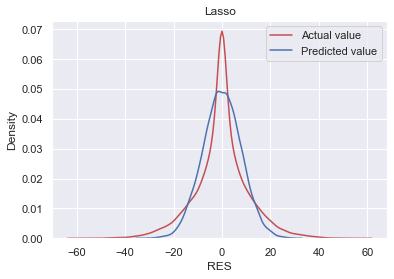

Lasso finished


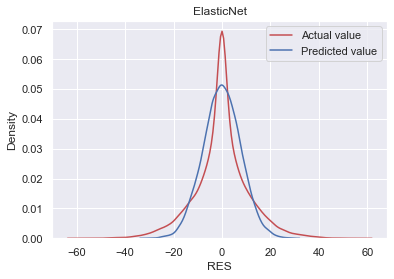

ElasticNet finished


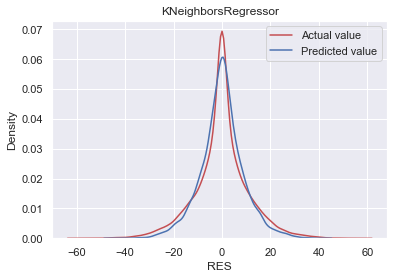

KNeighborsRegressor finished


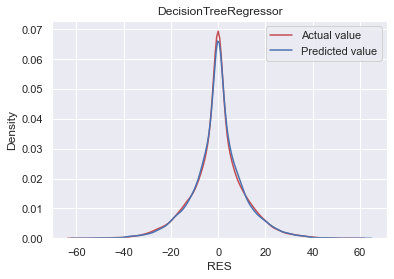

DecisionTreeRegressor finished


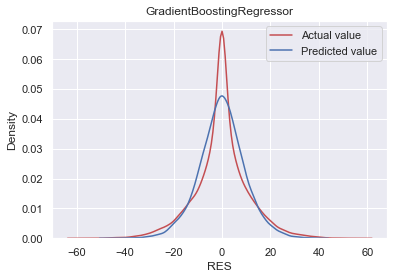

GradientBoostingRegressor finished


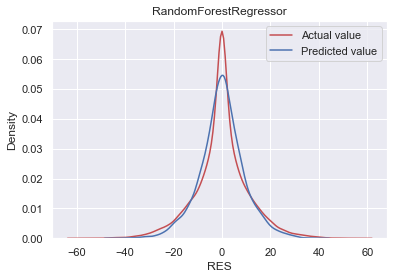

RandomForestRegressor finished


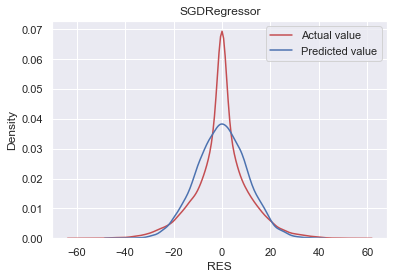

SGDRegressor finished


In [378]:
list_of_models = [
    LinearRegression,
    Ridge, 
    Lasso, 
    ElasticNet, 
    KNeighborsRegressor, 
    DecisionTreeRegressor, 
    GradientBoostingRegressor, 
    RandomForestRegressor,
    SGDRegressor
]
dict_of_params = {
    LinearRegression: {'n_jobs': -1},
    KNeighborsRegressor: {'n_jobs': -1},
    RandomForestRegressor: {'n_jobs': -1},
}

df_scores = compare_models(x_train_encoded, y_train, 
                           x_test_encoded, y_test, 
                           models=list_of_models, 
                           models_params=dict_of_params)

In [379]:
df_scores

,model,mae,mse,rmse,r2_square
0,LinearRegression,3.068520,15.901678,3.987691,0.870468
0,Ridge,3.068506,15.901730,3.987697,0.870467
0,Lasso,3.990604,29.293608,5.412357,0.761380
0,ElasticNet,3.945018,29.361224,5.418600,0.760829
0,KNeighborsRegressor,3.883206,26.944399,5.190799,0.780516
0,DecisionTreeRegressor,5.582210,55.680758,7.461954,0.546435
0,GradientBoostingRegressor,3.411687,20.642619,4.543415,0.831849
0,RandomForestRegressor,3.625118,23.472741,4.844868,0.808795
0,SGDRegressor,3.093706,15.995524,3.999440,0.869703


    Преобразование данных не дает выигрыша лучшей модели

##### Вывод
    LinearRegression c L2 регуляризацией показывает самые лучшие результаты
     
     

### 4. Сравнение оценки на данных со всеми признаками

In [380]:
x_full = data.drop('RES', axis='columns')
y_full = data['RES']
x_train, x_test, y_train, y_test = train_test_split(x_full, y_full, random_state=42)

print(f'X_train shape = {x_train.shape},\n'
      f'X_test shape = {x_test.shape}')

X_train shape = (37500, 54),
X_test shape = (12500, 54)


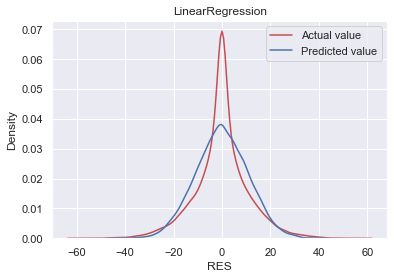

LinearRegression finished


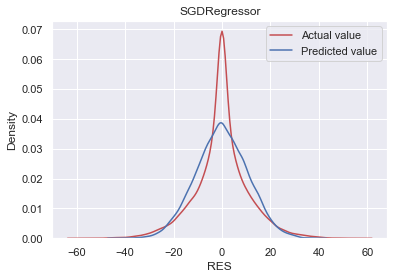

SGDRegressor finished


In [381]:
list_of_models = [
    LinearRegression,
    SGDRegressor
]
dict_of_params = {
    LinearRegression: {'n_jobs': -1},
}

df_scores = compare_models(x_train, y_train, 
                           x_test, y_test, 
                           models=list_of_models, 
                           models_params=dict_of_params)

In [382]:
df_scores

,model,mae,mse,rmse,r2_square
0,LinearRegression,1.865706,5.700883,2.387652,0.953562
0,SGDRegressor,1.885596,5.981292,2.445668,0.951277


##### Выводы    
- Линейная регрессия (с L2 регуляризацией) наиболее простая модель среди лучших
- Оценка со всеми признаками R2 = 0.95, RMSE = 2.39, а оценка с 19 из 54 признаков R2 = 0.874, RMSE = 3.98. Небольшое уменьшение качества при значительном уменьшении признаков
